Some helpers

In [ ]:
from IPython.display import Audio, display
from matplotlib import pyplot as plt

import torch
import torchaudio

from src.transforms.mel_spectrogram import MelSpectrogram, MelSpectrogramConfig

def visualize_audio(wav: torch.Tensor, sr: int = 22050, title: str = "Audio"):
    if wav.dim() == 2:
        wav = wav.mean(dim=0)

    if sr != 22050:
        wav = torchaudio.functional.resample(wav, orig_freq=sr, new_freq=22050)
        sr = 22050
        
    mel_transform = MelSpectrogram(MelSpectrogramConfig())
    mel = mel_transform(wav.unsqueeze(0))
    mel = mel.squeeze(0).cpu()

    fig, axs = plt.subplots(1, 2, figsize=(25, 5))

    axs[0].plot(wav, alpha=.7, c='green')
    axs[0].set_title(title, size=22)
    axs[0].set_xlabel('Time', size=20)
    axs[0].set_ylabel('Amplitude', size=20)
    axs[0].grid(True)

    im = axs[1].imshow(mel, aspect='auto', origin='lower')
    axs[1].set_title("Mel Spectrogram", size=22)
    axs[1].set_xlabel("Frames", size=20)
    axs[1].set_ylabel("Mel bins", size=20)
    fig.colorbar(im, ax=axs[1])

    plt.tight_layout()
    plt.show()

    display(Audio(wav, rate=sr, normalize=False))

def visualize_diff(wav1: torch.Tensor, wav2: torch.Tensor, sr: int = 22050, sr_orig: int = 22050):

    if wav1.dim() == 2:
        wav1 = wav1.mean(dim=0)
    if wav2.dim() == 2:
        wav2 = wav2.mean(dim=0)

    if sr != 22050:
        wav1 = torchaudio.functional.resample(wav1, orig_freq=sr_orig, new_freq=22050)
        wav2 = torchaudio.functional.resample(wav2, orig_freq=sr, new_freq=22050)
        sr = 22050


    mel_transform = MelSpectrogram(MelSpectrogramConfig())
    mel1 = mel_transform(wav1.unsqueeze(0)).squeeze(0).cpu()
    mel2 = mel_transform(wav2.unsqueeze(0)).squeeze(0).cpu()
    mel_diff = mel1 - mel2

    plt.figure(figsize=(12, 5))
    plt.imshow(mel_diff, aspect='auto', origin='lower', cmap='bwr')
    plt.title("Mel Spectrogram Diff", size=18)
    plt.xlabel("Frames", size=14)
    plt.ylabel("Mel bins", size=14)
    plt.colorbar()
    plt.show()

Inner-Analysis

Взял 5 записей из LJSpeech, прогнал на них вокодер. Представлены разные размеры аудио. есть очень короткие, как в обучающей выборке, так и длинные (~10c)

1) Printing, in the only sense with which we are at present concerned, differs from most if not from all the arts and crafts represented in the Exhibition

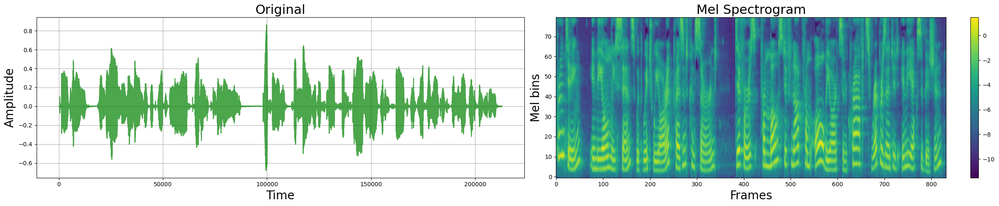

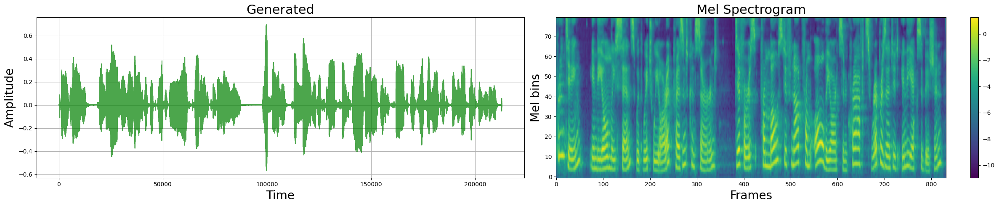

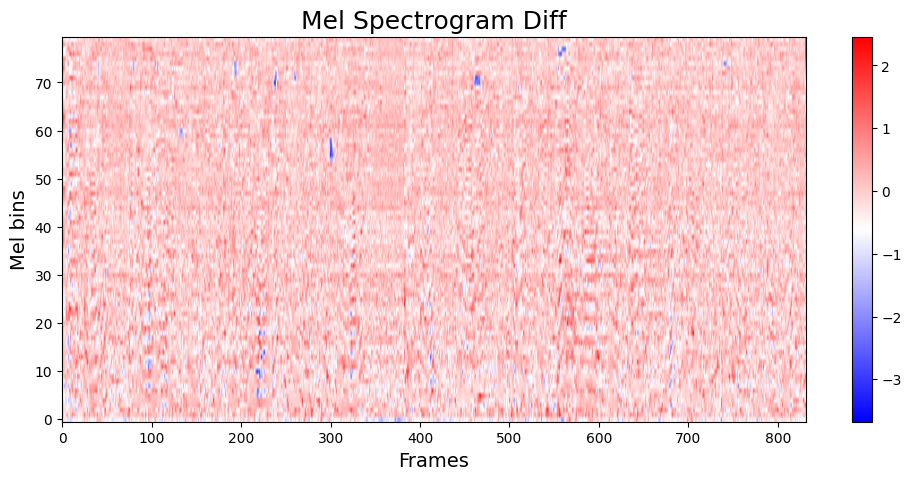

In [80]:
wav_t, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/inner_data/gt_audio/LJ001-0001.wav')
visualize_audio(wav_t, title="Original")

wav_f, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/inner_data/generated/LJ001-0001.wav')
visualize_audio(wav_f, title="Generated")

visualize_diff(wav_t, wav_f)

Видно, что отличается маштаб амплитуды, а так вообще забавно, что модель хорошо работает на длинных записях.

2. in being comparatively modern.

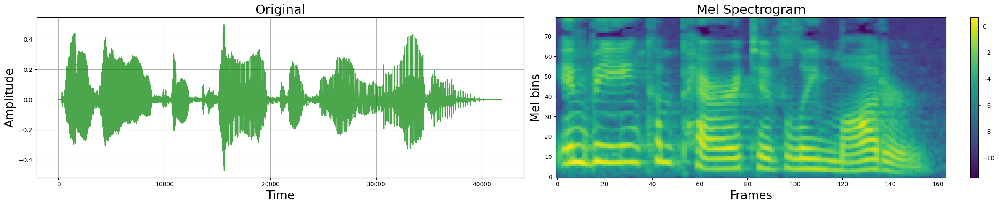

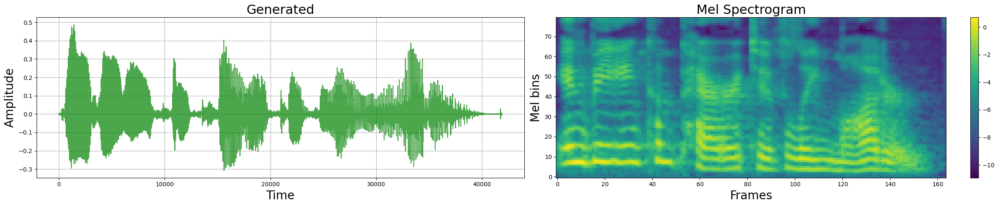

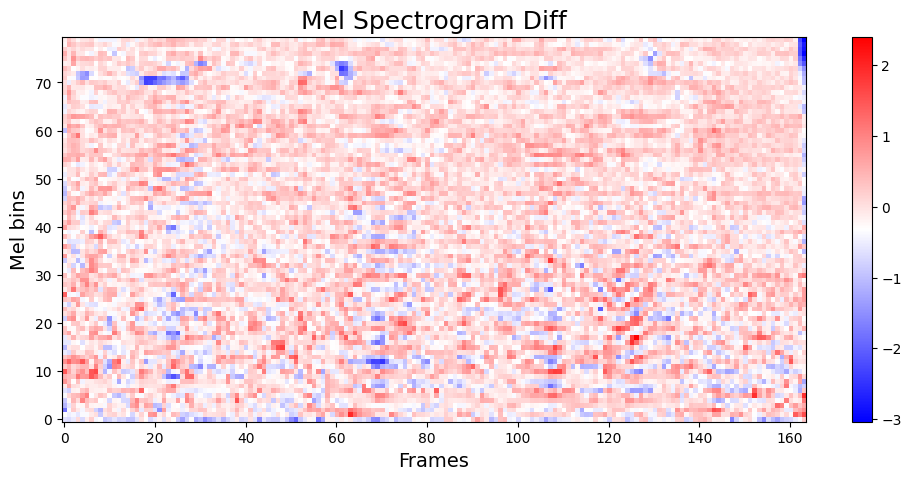

In [82]:
wav_t, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/inner_data/gt_audio/LJ001-0002.wav')
visualize_audio(wav_t, title="Original")

wav_f, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/inner_data/generated/LJ001-0002.wav')
visualize_audio(wav_f, title="Generated")

visualize_diff(wav_t, wav_f)

Нет разницы в качестве в зависимости от размера аудио (ну пока этот дифф хотя бы <10с). По картинке с аудио видно, что между ними очевидный дифф

3. For although the Chinese took impressions from wood blocks engraved in relief for centuries before the woodcutters of the Netherlands, by a similar process

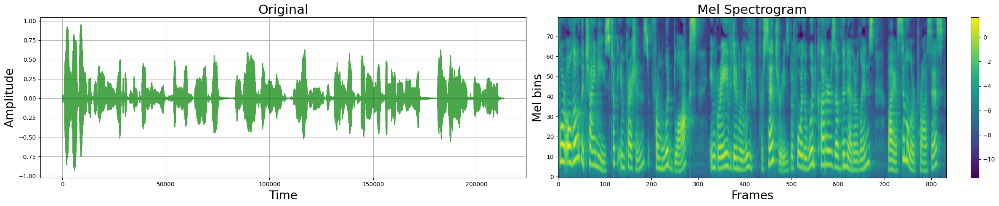

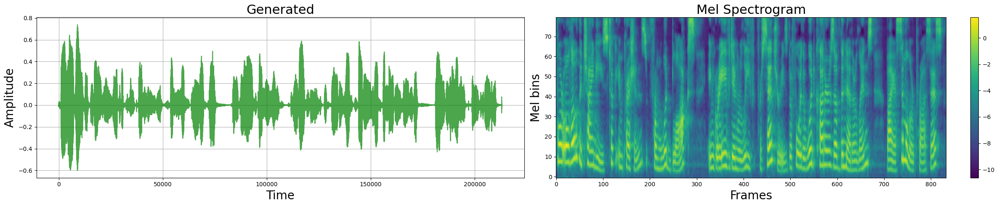

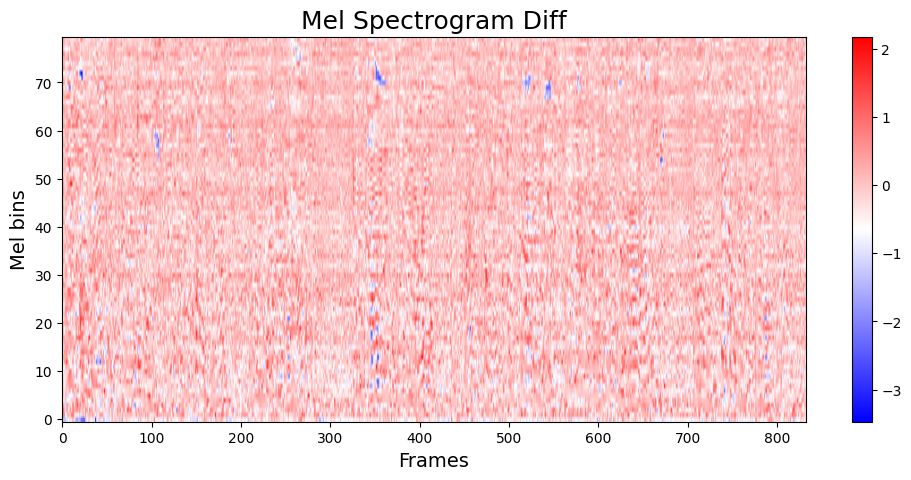

In [85]:
wav_t, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/inner_data/gt_audio/LJ001-0003.wav')
visualize_audio(wav_t, title="Original")

wav_f, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/inner_data/generated/LJ001-0003.wav')
visualize_audio(wav_f, title="Generated")

visualize_diff(wav_t, wav_f)

4. produced the block books, which were the immediate predecessors of the true printed book,

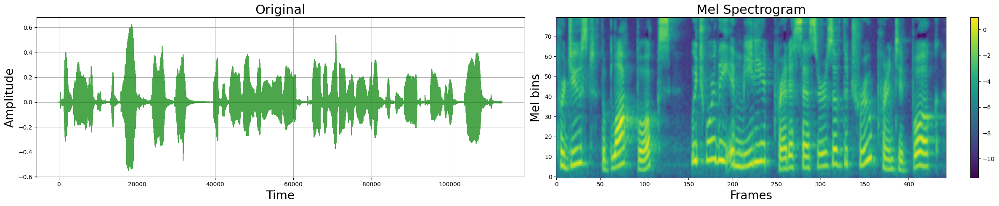

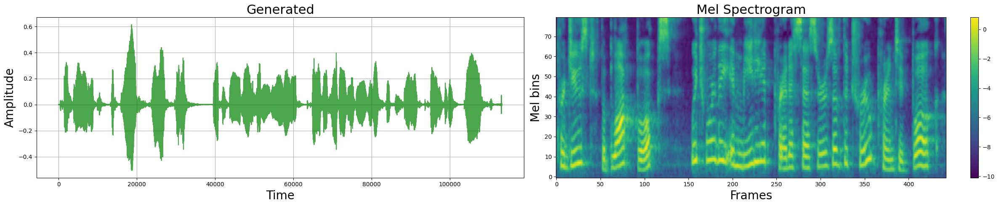

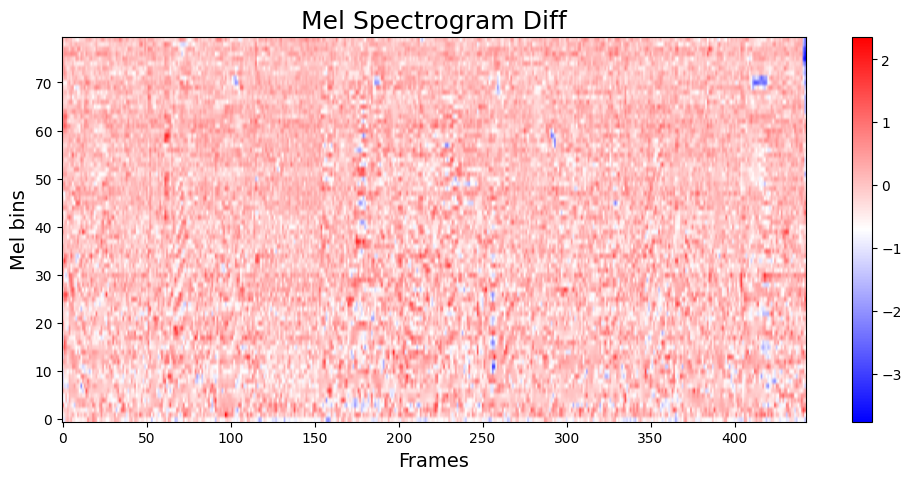

In [87]:
wav_t, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/inner_data/gt_audio/LJ001-0004.wav')
visualize_audio(wav_t, title="Original")

wav_f, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/inner_data/generated/LJ001-0004.wav')
visualize_audio(wav_f, title="Generated")

visualize_diff(wav_t, wav_f)

По мел спеке видно, что в верхних частотах есть сильный дифф: у вокодера более глубокий синий, это значит, что он делает энегрию у данных частот меньше

5. the invention of movable metal letters in the middle of the fifteenth century may justly be considered as the invention of the art of printing.

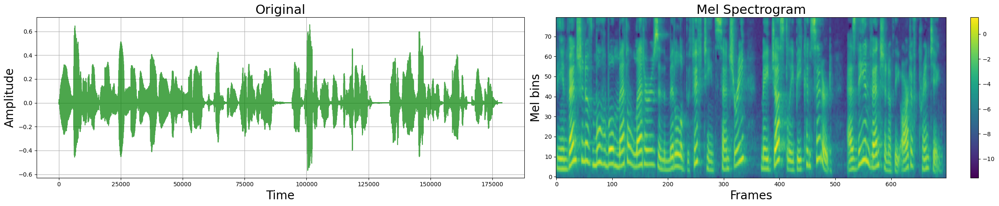

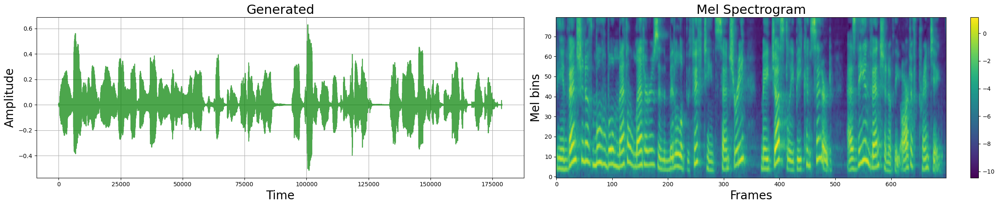

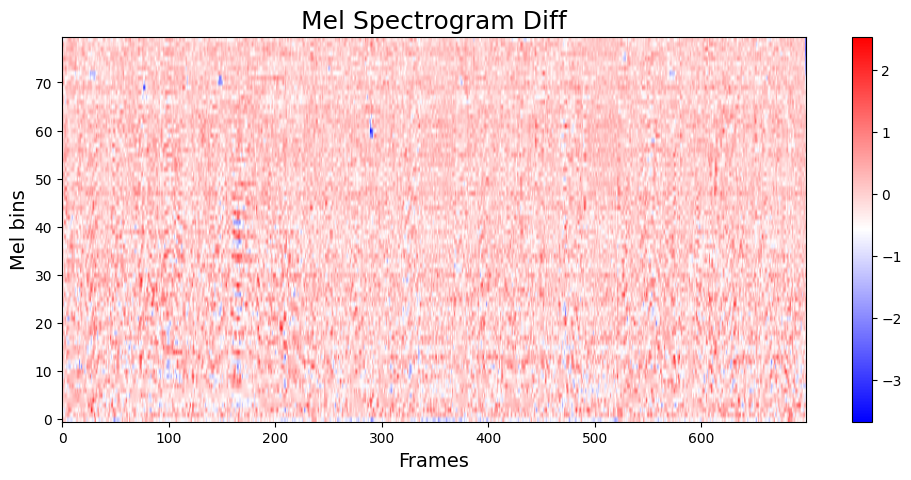

In [89]:
wav_t, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/inner_data/gt_audio/LJ001-0005.wav')
visualize_audio(wav_t, title="Original")

wav_f, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/inner_data/generated/LJ001-0005.wav')
visualize_audio(wav_f, title="Generated")

visualize_diff(wav_t, wav_f)

Анализ:

1) Разница между сгенерированным аудио и реальным есть. Как мне кажется в основном она проявляется 1) неестественный шум на заднем фоне 2) неправильно раставленные интонации. Как мне кажется, именно в оснвном выдает фейк от оригинала.
2) Если смотреть исключительно на картинку аудио, то можно найти отличия. Иногда есть отчетленый дифф между максимальным и минимальным значениями амплитуды, которые получаются у реального и сгенерированного аудио. Однозначного ответа нет, были случаи когда у сгенерирвонного аудио амплитуда больше (2) и когда меньше (1, 4)
3) Если смотреть на спекторагммы, то мне кажется, что можно увидеть более явное отличие. На всех спектрограммах из LJSPEECH видно, что вокодер уменьшает энегрию у верхних частот (например это можно заметить как более глубоких синий цвет в верхней части экрана). А это как раз значит, что у нас будет меньше высоких частот, то есть звук будет более тусклый

Выводы: лучший способ определить аудио реально или фейк это его послушать, в целом если приловчиться, то можно смотреть на спеку, а именно на то как режутся верхние частоты, в целом я доволен качеством генерации на данном срезе данных, особенно интересно, чтобы работает одинаково все зависимости от размера аудио. Как мне кажется это обсловлено процессом обучение, а именно случайной нарезкой аудио на небольшие кусочки, такой подход позволяет учесть всякие переходы между словами, паузы и прочее.

External Dataset Analysis

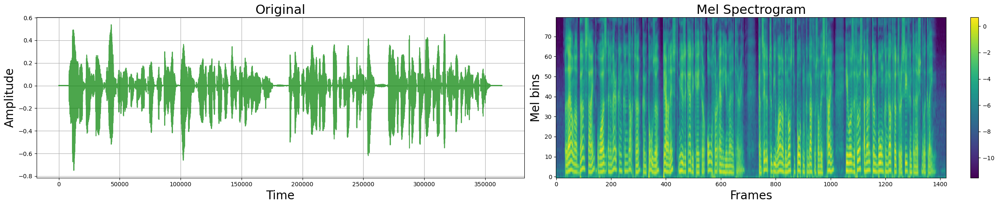

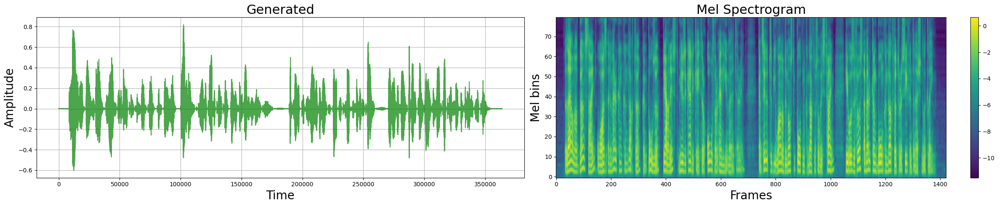

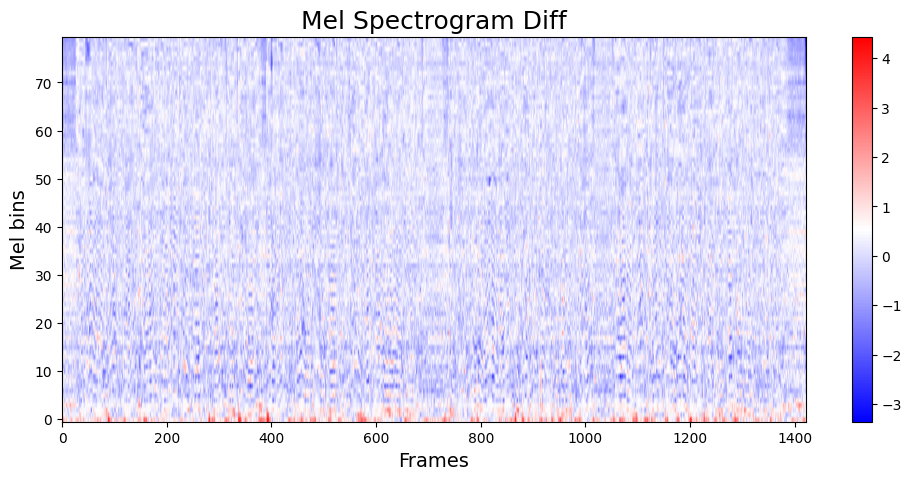

In [91]:
wav_t, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/test_audio/gt_audio/bernstein.wav')
visualize_audio(wav_t, sr, title="Original")

wav_f, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/test_audio/generated/bernstein.wav')
visualize_audio(wav_f, sr, title="Generated")

visualize_diff(wav_t, wav_f)

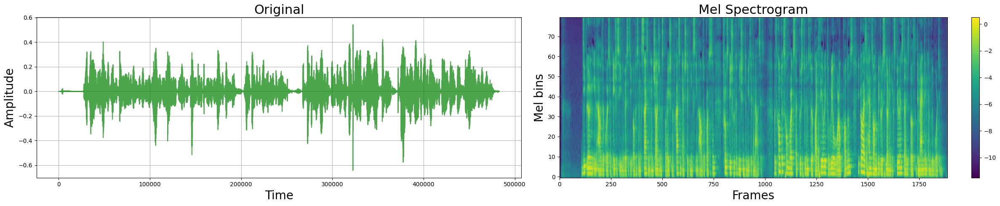

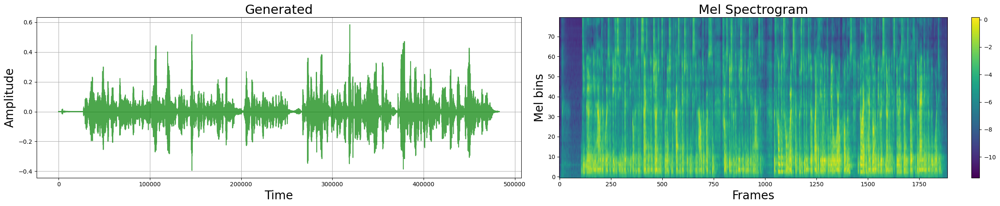

RuntimeError: The size of tensor a (3775) must match the size of tensor b (1888) at non-singleton dimension 1

In [93]:
wav_t, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/test_audio/gt_audio/dla.wav')
visualize_audio(wav_t, sr, title="Original")

wav_f, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/test_audio/generated/dla.wav')
visualize_audio(wav_f, title="Generated")

visualize_diff(wav_t, wav_f)

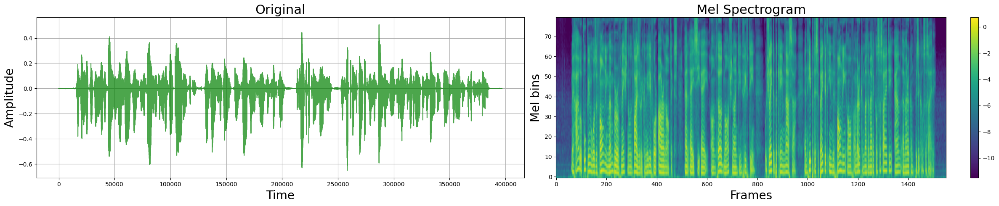

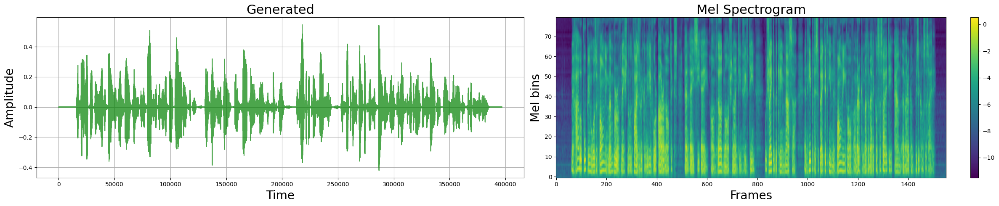

In [57]:
wav, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/test_audio/gt_audio/pupin.wav')
visualize_audio(wav, sr, title="Original")

wav, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/test_audio/generated/pupin.wav')
visualize_audio(wav, title="Generated")

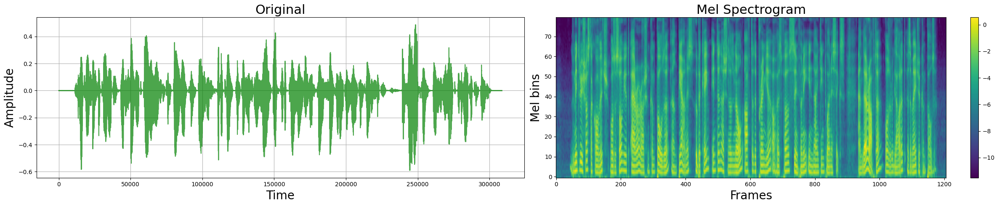

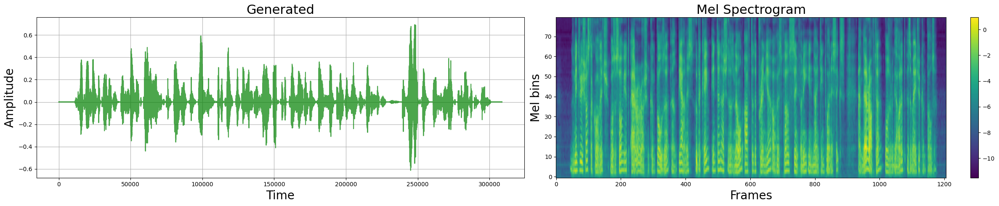

In [58]:
wav, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/test_audio/gt_audio/shostakovich.wav')
visualize_audio(wav, sr, title="Original")

wav, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/test_audio/generated/shostakovich.wav')
visualize_audio(wav, title="Generated")

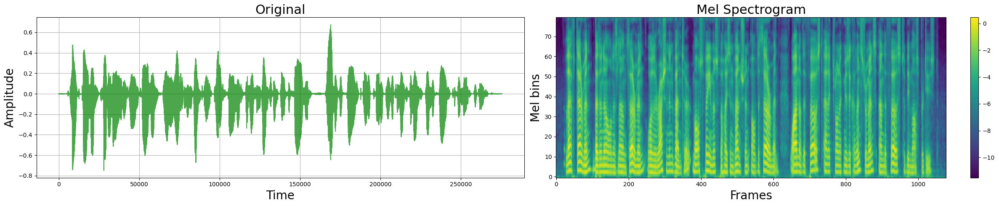

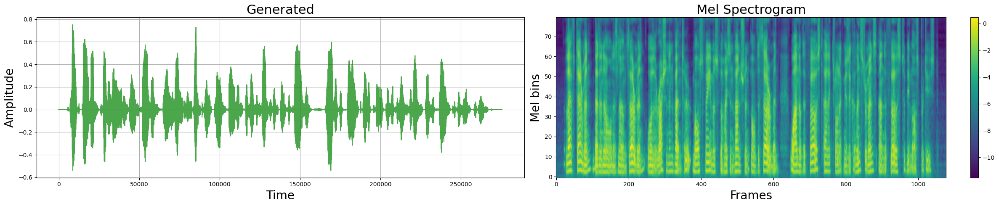

In [59]:
wav, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/test_audio/gt_audio/termen.wav')
visualize_audio(wav, sr, title="Original")

wav, sr = torchaudio.load('/home/boboxa/junk/neural_vocoder/test_audio/generated/termen.wav')
visualize_audio(wav, title="Generated")

Full-TTS system Analysis

Оценка 4. There is some obvious noise, but all the words are clear and you do not have to listen to them to understand